# ECSE 415 - Assignment 1: Image Filtering


Mathieu-Joseph Magri, 260928498

In [70]:
#Import Statements
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import cv2
import numpy as np

#Google Drive Mount
from google.colab import drive
drive.mount('/content/drive')

#Path Variable for images
path = '/content/drive/MyDrive/ECSE_415/Assignments/A1/images/'

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Question 1: Denoising (20 Points)


Question 1.1 Gaussian Noise

Part 1.1.1:

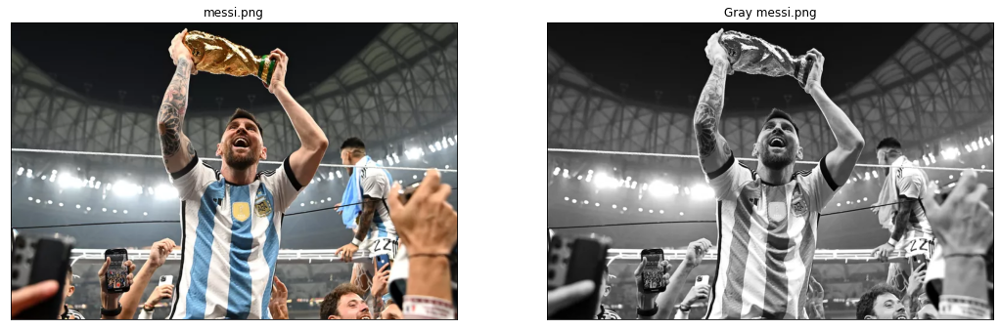

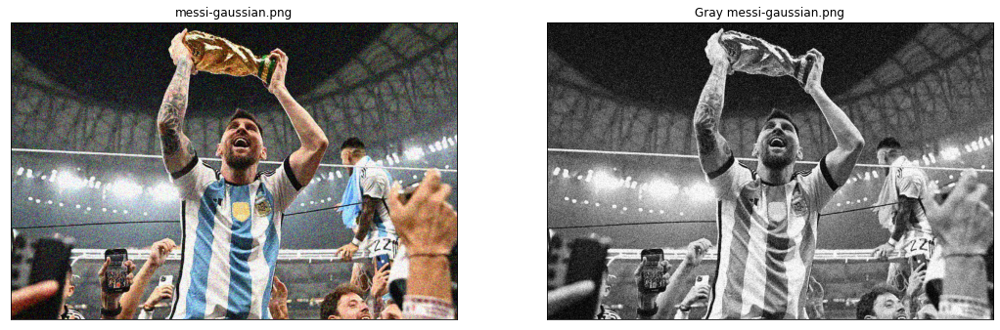

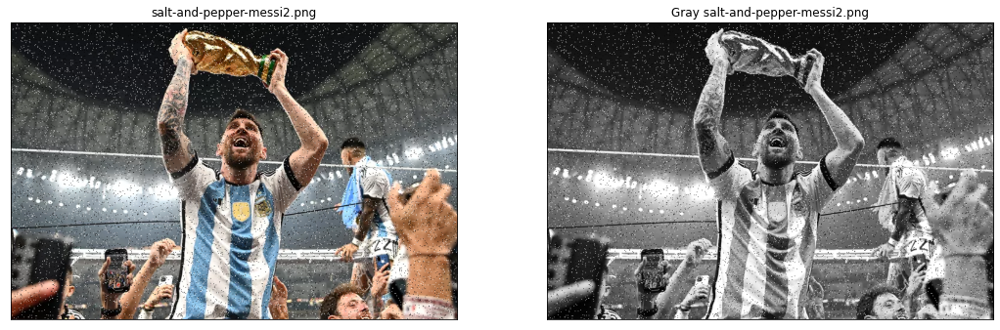

In [71]:
#Step 1: Converting the messi.png coloured image to a greyscale image

#Convert all Messi images to coloured images, and then grey images
#Original Messi image
imageMessi = cv2.imread(path+'messi.png') # BGR
imageMessi = cv2.cvtColor(imageMessi, cv2.COLOR_BGR2RGB)


grayMessi = cv2.cvtColor(imageMessi, cv2.COLOR_RGB2GRAY) #Messi converted to gray


#Gaussian Messi image
imageMessiGaussian = cv2.imread(path+'messi-gaussian.png') # BGR
imageMessiGaussian = cv2.cvtColor(imageMessiGaussian, cv2.COLOR_BGR2RGB)


grayMessiGaussian = cv2.cvtColor(imageMessiGaussian, cv2.COLOR_RGB2GRAY) #MessiGaussian converted to gray


#Salt and Pepper Messi image
imageSandPMessi = cv2.imread(path+'salt-and-pepper-messi2.png') # BGR
imageSandPMessi = cv2.cvtColor(imageSandPMessi, cv2.COLOR_BGR2RGB)


graySandPMessi = cv2.cvtColor(imageSandPMessi, cv2.COLOR_RGB2GRAY) #MessiSandP converted to gray


#plot all images
plt.figure(figsize=(18,18))
plt.subplot(121), plt.imshow(imageMessi)
plt.title("messi.png"), plt.xticks([]), plt.yticks([])

plt.subplot(122), plt.imshow(grayMessi, cmap='gray')
plt.title("Gray messi.png"), plt.xticks([]), plt.yticks([])
plt.show()

plt.figure(figsize=(18,18))
plt.subplot(121), plt.imshow(imageMessiGaussian)
plt.title("messi-gaussian.png"), plt.xticks([]), plt.yticks([])

plt.subplot(122), plt.imshow(grayMessiGaussian, cmap='gray')
plt.title("Gray messi-gaussian.png"), plt.xticks([]), plt.yticks([])
plt.show()

plt.figure(figsize=(18,18))
plt.subplot(121), plt.imshow(imageSandPMessi)
plt.title("salt-and-pepper-messi2.png"), plt.xticks([]), plt.yticks([])

plt.subplot(122), plt.imshow(graySandPMessi, cmap='gray')
plt.title("Gray salt-and-pepper-messi2.png"), plt.xticks([]), plt.yticks([])
plt.show()

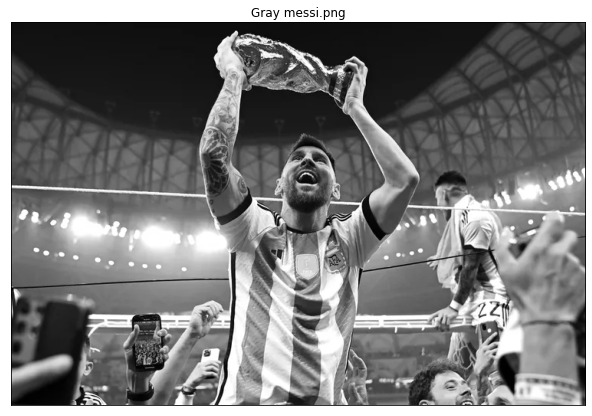

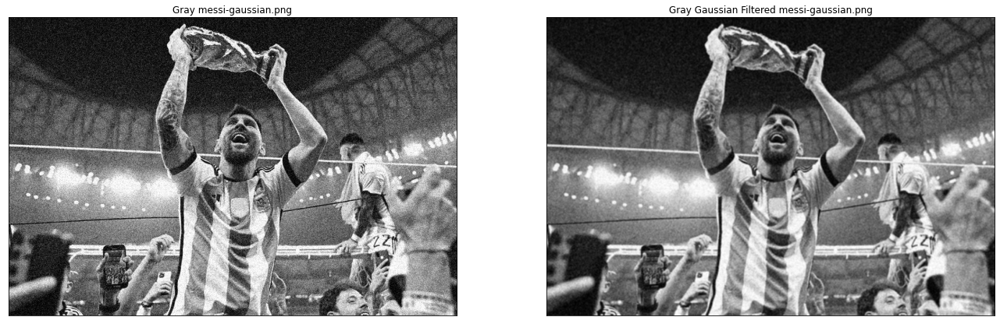

In [72]:
#Step 2: Creating a Gaussian filter and a Box filter from sratch


#NOTE: The Gaussian filter function was heavily inspired from the Gaussian Filter function developped in Tutorial 3.
#Gaussian Filter function
#Size: The size of the square gaussian kernel.
#Sigma: Sigma value used for the gaussian
def gaussian_kernel(size, sigma):
  xyDimensions = size // 2 #Need to do floor/integer division to get the appropriate sizes of the x and y coordinates array
 
  #x and y coordinates arrays for the calculation of the gaussian
  xCoords, yCoords = np.mgrid[-xyDimensions:xyDimensions+1, -xyDimensions:xyDimensions+1] #np.mgrid creates x and y grids, same function used in Turotial 3

  #Calculating Kernel values
  norm = (1/(2*np.pi*(sigma**2)))
  expArg = -((xCoords**2+yCoords**2)/(2*(sigma**2)))
  exp = np.exp(expArg)
  unnormalizedGaussian = norm*exp
  sumGaussian = np.sum(unnormalizedGaussian) #Normalizing the Gaussian Kernel
  finalGaussian = unnormalizedGaussian/sumGaussian

  return finalGaussian
  


#FILTERING THE NOISY IMAGE USING A 3X3 GAUSSIAN FILTER WITH VARIANCE EQUAL TO 3

#Create filter
gaussianFilter = gaussian_kernel(3, np.sqrt(3))
#Apply Filter
filtered_imageGauss = cv2.filter2D(grayMessiGaussian, -1, gaussianFilter)

#Plot images
plt.figure(figsize=(35, 35))
plt.subplot(131), plt.imshow(grayMessi, cmap='gray')
plt.title("Gray messi.png"), plt.xticks([]), plt.yticks([])
plt.show()

plt.figure(figsize=(35, 35))
plt.subplot(131), plt.imshow(grayMessiGaussian, cmap='gray')
plt.title("Gray messi-gaussian.png"), plt.xticks([]), plt.yticks([])

plt.subplot(132), plt.imshow(filtered_imageGauss, cmap='gray')
plt.title("Gray Gaussian Filtered messi-gaussian.png"), plt.xticks([]), plt.yticks([])
plt.show()


#DEBUGGING PURPOSES
#gaussian_kernel(5, np.sqrt(1))



   



Part 1.1.2:

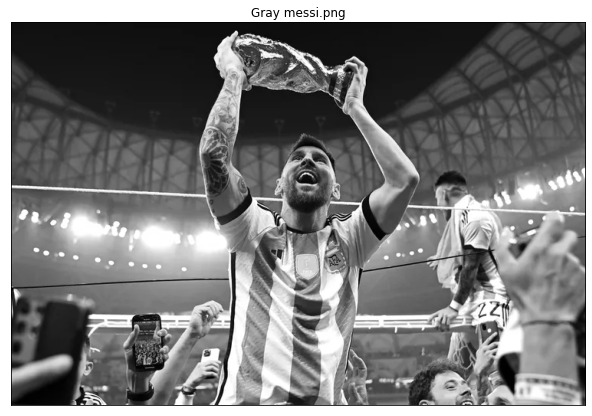

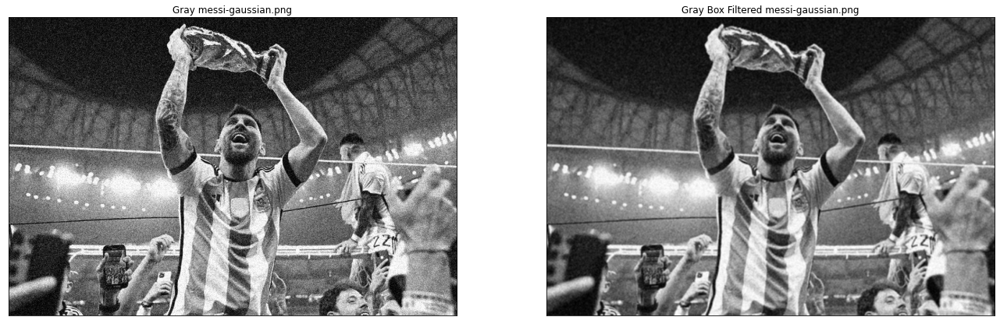

In [73]:
#FILTER THE NOISY IMAGE USING A BOX FILTER OF THE SAME SIZE (3X3)

#Box Filter made from scratch, no outside sources used
#Box kernel function
#Size: The size of the square box filter
def box_kernel(size):
  xyDimensions = size
  box = np.ones([xyDimensions,xyDimensions])
  sum = np.sum(box)
  box_filter = (box/sum)
  return box_filter

#Create filter
box_filter = box_kernel(3)
#Filter Image
filtered_imageBox = cv2.filter2D(grayMessiGaussian, -1, box_filter)

#Plot images
plt.figure(figsize=(35, 35))
plt.subplot(131), plt.imshow(grayMessi, cmap='gray')
plt.title("Gray messi.png"), plt.xticks([]), plt.yticks([])
plt.show()

plt.figure(figsize=(35, 35))
plt.subplot(131), plt.imshow(grayMessiGaussian, cmap='gray')
plt.title("Gray messi-gaussian.png"), plt.xticks([]), plt.yticks([])

plt.subplot(132), plt.imshow(filtered_imageBox, cmap='gray')
plt.title("Gray Box Filtered messi-gaussian.png"), plt.xticks([]), plt.yticks([])
plt.show()


Part 1.1.3:

In [74]:
#PEAK-TO-SIGNAL-TO-NOISE RATIO BETWEEN BOTH DENOISED IMAGES AND THE CLEAN IMAGE

psnrGauss = cv2.PSNR(grayMessi, filtered_imageGauss)
print('PSNR value for the image filtered with a 3x3 Gaussian filter with a variance of 3:\n', psnrGauss, '\n')

psnrBox = cv2.PSNR(grayMessi, filtered_imageBox)
print('PSNR value for the image filtered with a 3x3 Box filter:\n', psnrBox, '\n')

###########################
# DEBUGGING PURPOSES BELOW#
###########################

# filtered_imageGaussCV = cv2.GaussianBlur(grayMessiGaussian, (3,3), np.sqrt(3))
# psnrGaussCV = cv2.PSNR(grayMessi, filtered_imageGaussCV)
# print('PSNR value for the image filtered with a 3x3 Gaussian filter with a variance of 3 in OpenCV:\n', psnrGaussCV, '\n')

# kernel = np.ones((3,3), np.float32)/(3*3)
# filtered_imageBoxCV = cv2.filter2D(grayMessiGaussian, -1, kernel)
# psnrBoxCV = cv2.PSNR(grayMessi, filtered_imageBoxCV)
# print('PSNR value for the image filtered with a 3x3 Box filter in OpenCV:\n', psnrBoxCV, '\n')





PSNR value for the image filtered with a 3x3 Gaussian filter with a variance of 3:
 26.29479603624449 

PSNR value for the image filtered with a 3x3 Box filter:
 26.048375281082606 



The PSNR value obtained using the 3x3 Gaussian filter with a variance of 3 is higher than the PSNR value obtained using the 3x3 Box filter. Therefore, we can conclude from these results that the Gaussian filter did a better job at maintaining the original image's integrity, and thus a better job at filtering the image while maintaining the most similarity possible with the original gray Messi image.

Question 1.2: Salt and Pepper Noise

Part 1.2.1:

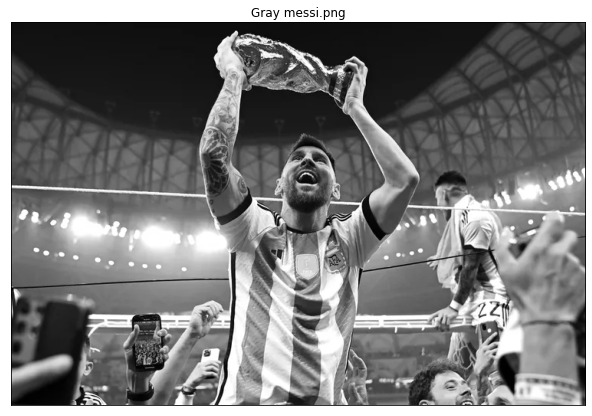

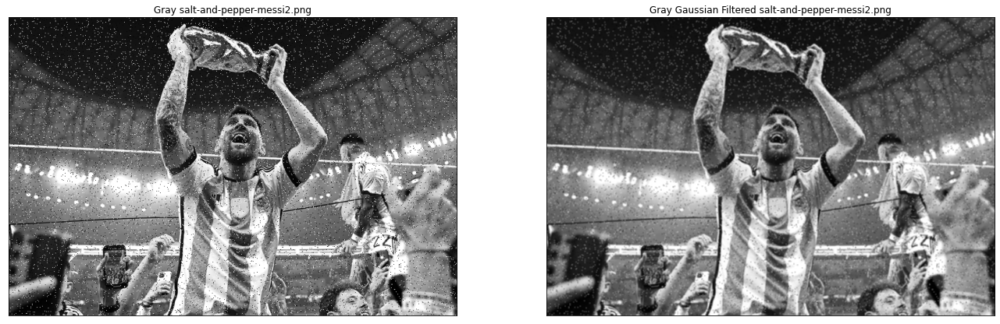

In [75]:
#FILTER THE SALT-AND-PEPPER IMAGE USING THE SAME GAUSSIAN FILTER AS ABOVE

#Create filter
gaussianFilter = gaussian_kernel(3, np.sqrt(3))
#Filter images
filtered_imageSandPGauss = cv2.filter2D(graySandPMessi, -1, gaussianFilter)

#Plot images
plt.figure(figsize=(35, 35))
plt.subplot(131), plt.imshow(grayMessi, cmap='gray')
plt.title("Gray messi.png"), plt.xticks([]), plt.yticks([])
plt.show()

plt.figure(figsize=(35, 35))
plt.subplot(131), plt.imshow(graySandPMessi, cmap='gray')
plt.title("Gray salt-and-pepper-messi2.png"), plt.xticks([]), plt.yticks([])

plt.subplot(132), plt.imshow(filtered_imageSandPGauss, cmap='gray')
plt.title("Gray Gaussian Filtered salt-and-pepper-messi2.png"), plt.xticks([]), plt.yticks([])
plt.show()


Part 1.2.2:

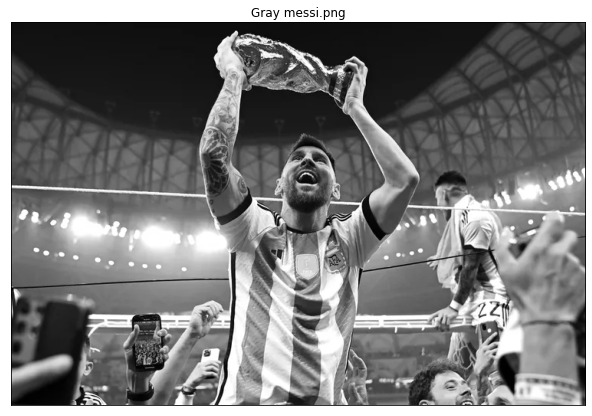

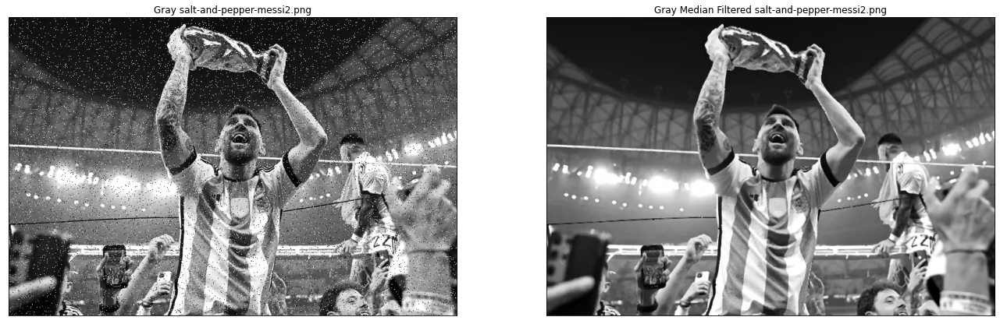

In [76]:
#FILTER USING A MEDIAN FILTER OF THE SAME SIZE
#NOTE: The below medianFilter function was inspired by the median filter code developped in Tutorial 2.
#First, we must create the Median filter
def medianFilter(image, size):

    pad_size = np.floor(size/2).astype("uint8") #Calculate the pad size to apply to the image (3x3 kernel means 1 pixel to each side)

    #Padding the image. The Constant padding constant is 0.
    pad_input_image = np.pad(image, pad_width=int(pad_size), mode='constant', constant_values=0) #Using 0 adds no information, maintains boundary conditions that allows us to use all filters without worrying that the 0 changed anything

    # Get Height and Width of the original image.
    h, w = pad_input_image.shape #(392,514) padding entire image so both sides get padded and therefore +2 for each dimension

    # Making sure the output image and input image are alike
    outputImage = np.zeros_like(image)

    #Traversal through the image using two for loops
    for i in range(0, h - 2*pad_size): # 0, 390 because when we are at 390, we take values between 390-392
        for j in range(0, w - 2*pad_size): # 0, 512
            outputImage[i,j] = np.median(pad_input_image[i:i+size, j:j+size])

    return outputImage

#Filter image
filtered_imageSandPMedian = medianFilter(graySandPMessi, 3)

#Plot images
plt.figure(figsize=(35, 35))
plt.subplot(131), plt.imshow(grayMessi, cmap='gray')
plt.title("Gray messi.png"), plt.xticks([]), plt.yticks([])
plt.show()

plt.figure(figsize=(35, 35))
plt.subplot(131), plt.imshow(graySandPMessi, cmap='gray')
plt.title("Gray salt-and-pepper-messi2.png"), plt.xticks([]), plt.yticks([])


plt.subplot(132), plt.imshow(filtered_imageSandPMedian, cmap='gray')
plt.title("Gray Median Filtered salt-and-pepper-messi2.png"), plt.xticks([]), plt.yticks([])
plt.show()

   



PART 1.2.3:

In [77]:
#COMPARE THE PSNR VALUES OF BOTH FILTERED IMAGES WITH THE ORIGINAL IMAGE'S

#PEAK-TO-SIGNAL-TO-NOISE RATIO BETWEEN BOTH DENOISED IMAGES AND THE CLEAN IMAGE

psnrGaussSandP = cv2.PSNR(grayMessi, filtered_imageSandPGauss)
print('PSNR value for the image filtered with a 3x3 Gaussian filter with a variance of 3:\n', psnrGaussSandP, '\n')

psnrMedian = cv2.PSNR(grayMessi, filtered_imageSandPMedian)
print('PSNR value for the image filtered with a 3x3 Meidan filter:\n', psnrMedian, '\n')

###########################
# DEBUGGING PURPOSES BELOW#
###########################

# filtered_imageGaussCV = cv2.GaussianBlur(graySandPMessi, (3,3), np.sqrt(3))
# psnrGaussCV = cv2.PSNR(grayMessi, filtered_imageGaussCV)
# print('PSNR value for the image filtered with a 3x3 Gaussian filter with a variance of 3 in OpenCV:\n', psnrGaussCV, '\n')

# filtered_imageMedianCV = cv2.medianBlur(graySandPMessi, 3)
# psnrBoxCV = cv2.PSNR(grayMessi, filtered_imageMedianCV)
# print('PSNR value for the image filtered with a 3x3 Median filter in OpenCV:\n', psnrBoxCV, '\n')

# plt.figure(figsize=(35, 35))
# plt.subplot(131), plt.imshow(filtered_imageSandPMedian, cmap='gray')
# plt.title("Gray Filtered with Function salt-and-pepper-messi2.png"), plt.xticks([]), plt.yticks([])


# plt.subplot(132), plt.imshow(filtered_imageMedianCV, cmap='gray')
# plt.title("Gray Median Filtered with OpenCV salt-and-pepper-messi2.png"), plt.xticks([]), plt.yticks([])
# plt.show()


# diff_image = filtered_imageSandPMedian - filtered_imageMedianCV
# plt.figure(figsize=(15, 15))
# plt.subplot(224), plt.imshow(diff_image, cmap='gray')
# plt.title("Difference -- OpenCV vs Numpy"), plt.xticks([]), plt.yticks([])
# plt.show()



PSNR value for the image filtered with a 3x3 Gaussian filter with a variance of 3:
 24.54206660268435 

PSNR value for the image filtered with a 3x3 Meidan filter:
 29.75680999716765 



The PSNR value obtained using the 3x3 Gaussian filter with a variance of 3 is lower than the PSNR value obtained using the 3x3 Median filter. Therefore, we can conclude from these results that the Median filter did a better job at maintaining the original image's integrity, and thus a better job at filtering the image while maintaining the most similarity possible with the original gray Messi image.

PART 1.2.4:


Gaussian noise and Salt-and-pepper noise are different in a few ways. To start, Gaussian noise is an additive type of noise that can removed using linear methods such as using a Gaussian filter or a Box filter convolution.

To continue, Salt-and-pepper is noise caused by random occurences of black and white pixels, or red, green or blue pixels. Salt-and-pepper noise is multiplicative, meaning that it can't be handled appropriately using linear filtering methods. Non-linear filtering methods are often used to handle this sort of noise and get better results with multiplicative noise.

The best method for denoising each type of noise is also different. Indeed, for Gaussian noise, as said above, linear filtering methods should be used. The best linear filtering method we have seen so far to handle Gaussian noise is a convolution using a Gaussian filter. It is imporant to note, however, that Gaussian-type filters have a hard time filtering sharp, high frequency images. For Salt-and-pepper noise, the best way to denoise such an image would be to use a non-linear type of filtering method, the median filter being the best method we have seen thus far.

## Question 2: Canny Edge Detection (20 points)


Question 2.1: Briefly describe the 4 main steps of Canny edge detection.

From the class notes from Lecture 4, the 4 main steps of Canny edge detection are as follows: 

1. Filter the image with x and y derivatives of Gaussian. In this part, we reduce the noise of the original image using a Gaussian filter to smooth the image. We then calculate the x and y derivatives of the smoothed image. We can use Sobel filters for this step.

2. Find the magnitude and orientation of the gradient. For this step, we calculate the magnitude and orientation of the image using the derivatives calculated from part 1.

3. Apply Non-maximum suppression, where thin multi-pixel wide locations of our image ridges down to a single pixel widht. For this step, we check if a pixel is a local maximum along the gradient direction, and if it is not, we set it to 0. We simplify the process by quantizing the gradient into one of 8 possible directions.

4. Apply Thresholding and Linking (also known as Hysteresis). For this part, we define two thresholds, one low threshold and one high threshold. Then we use the high threshold to start edge curves and the low threshold to continue them accordingly. To link edges together, we scan an image row-by-row from left-to-right and check if the pixel has a "strong edge" pixel as a neighbour. If so, we mark it as a pixel that participates in a strong edge, if not, we do not mark it. We complete this scan 4 times with 4 different starting points: the upper left corner, the lower left corner, the lower right corner, and the uppper right corner.



Question 2.2: Canny edge detection parameter analysis.

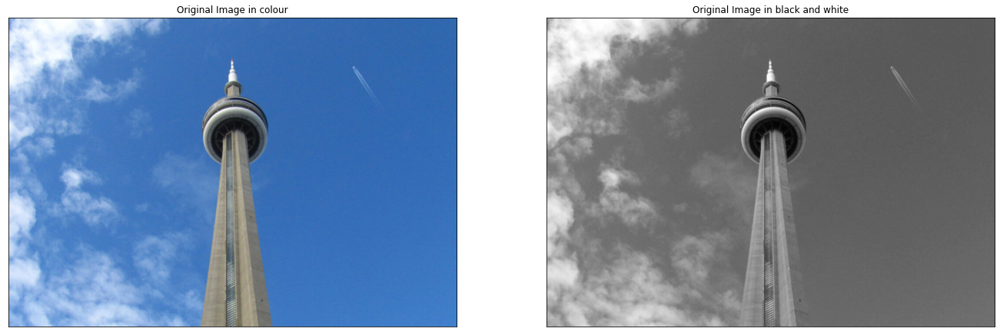

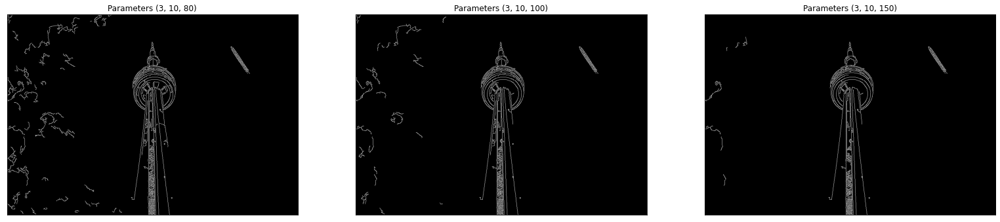

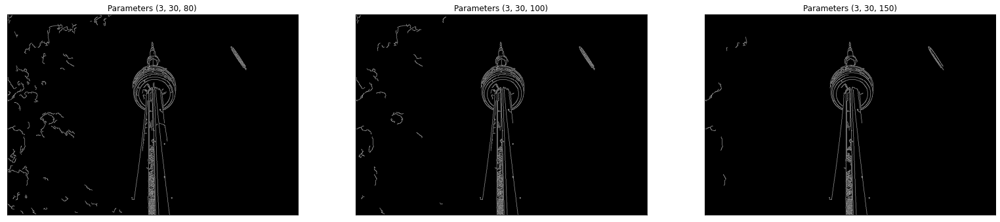

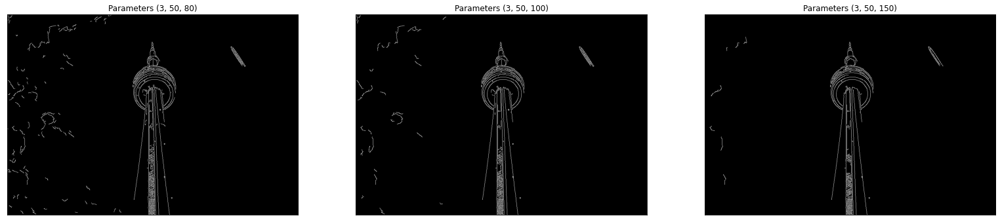

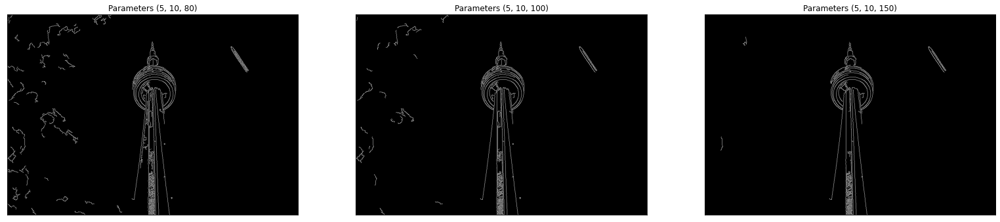

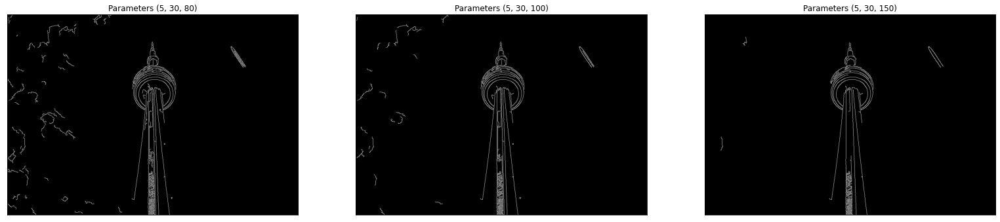

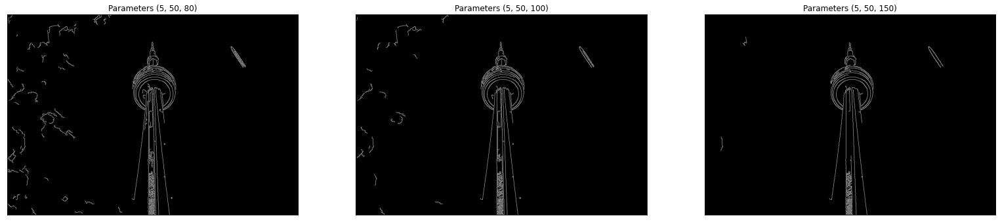

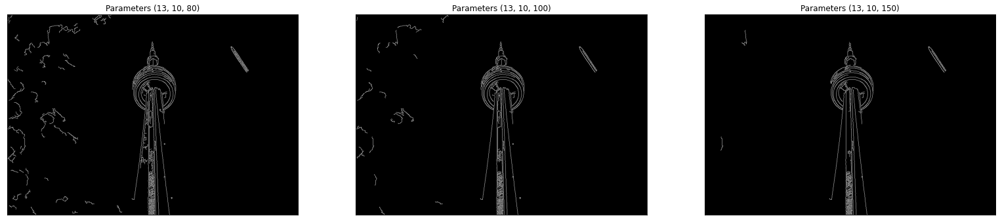

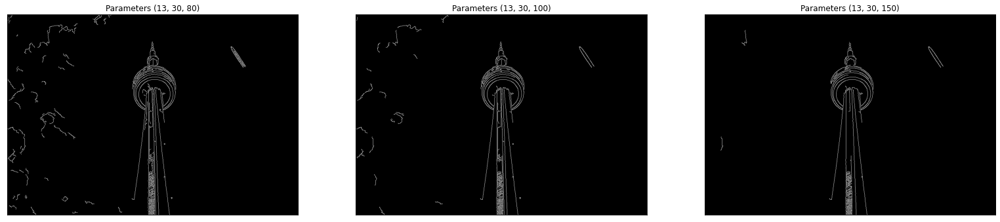

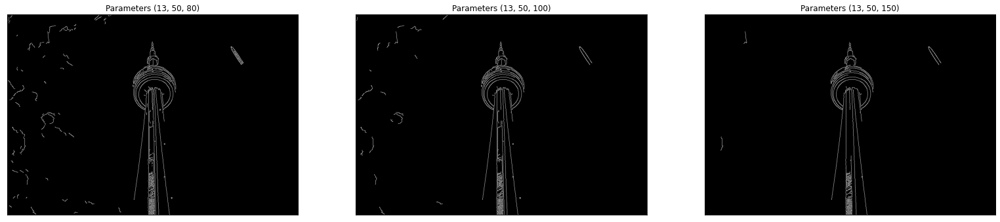

In [78]:
#PARAMETER ANALYSIS

#Original image
imageCNTower = cv2.imread(path+'cntower.jpg')
imageCNTowerColour = cv2.cvtColor(imageCNTower, cv2.COLOR_BGR2RGB)
imageCNTowerGrey = cv2.cvtColor(imageCNTowerColour, cv2.COLOR_RGB2GRAY)

#Plot images
plt.figure(figsize=(23, 23))
plt.subplot(121), plt.imshow(imageCNTowerColour)
plt.title("Original Image in colour"), plt.xticks([]), plt.yticks([])
plt.subplot(122), plt.imshow(imageCNTowerGrey, cmap="gray")
plt.title("Original Image in black and white"), plt.xticks([]), plt.yticks([])
plt.show()

#Creating all 27 images for Canny Edge Detection

#(3, 10, 80)
img_gauss1 = cv2.GaussianBlur(imageCNTowerGrey, (3, 3), 1)
img_edge_cv1 = cv2.Canny(img_gauss1, 10, 80)

#(3, 10, 100)
img_gauss2 = cv2.GaussianBlur(imageCNTowerGrey, (3, 3), 1)
img_edge_cv2 = cv2.Canny(img_gauss2, 10, 100)

#(3, 10, 150)
img_gauss3 = cv2.GaussianBlur(imageCNTowerGrey, (3, 3), 1)
img_edge_cv3 = cv2.Canny(img_gauss3, 10, 150)

# display images
plt.figure(figsize=(27, 27))

plt.subplot(131), plt.imshow(img_edge_cv1, cmap="gray")
plt.title("Parameters (3, 10, 80)"), plt.xticks([]), plt.yticks([])
plt.subplot(132), plt.imshow(img_edge_cv2, cmap="gray")
plt.title("Parameters (3, 10, 100)"), plt.xticks([]), plt.yticks([])
plt.subplot(133), plt.imshow(img_edge_cv3, cmap="gray")
plt.title("Parameters (3, 10, 150)"), plt.xticks([]), plt.yticks([])

plt.show()

##############


#(3, 30, 80)
img_gauss4 = cv2.GaussianBlur(imageCNTowerGrey, (3, 3), 1)
img_edge_cv4 = cv2.Canny(img_gauss4, 30, 80)

#(3, 30, 100)
img_gauss5 = cv2.GaussianBlur(imageCNTowerGrey, (3, 3), 1)
img_edge_cv5 = cv2.Canny(img_gauss5, 30, 100)

#(3, 30, 150)
img_gauss6 = cv2.GaussianBlur(imageCNTowerGrey, (3, 3), 1)
img_edge_cv6 = cv2.Canny(img_gauss6, 30, 150)

# display images
plt.figure(figsize=(27, 27))

plt.subplot(131), plt.imshow(img_edge_cv4, cmap="gray")
plt.title("Parameters (3, 30, 80)"), plt.xticks([]), plt.yticks([])
plt.subplot(132), plt.imshow(img_edge_cv5, cmap="gray")
plt.title("Parameters (3, 30, 100)"), plt.xticks([]), plt.yticks([])
plt.subplot(133), plt.imshow(img_edge_cv6, cmap="gray")
plt.title("Parameters (3, 30, 150)"), plt.xticks([]), plt.yticks([])

plt.show()

###############

#(3, 50, 80)
img_gauss7 = cv2.GaussianBlur(imageCNTowerGrey, (3, 3), 1)
img_edge_cv7 = cv2.Canny(img_gauss7, 50, 80)

#(3, 50, 100)
img_gauss8 = cv2.GaussianBlur(imageCNTowerGrey, (3, 3), 1)
img_edge_cv8 = cv2.Canny(img_gauss8, 50, 100)

#(3, 50, 150)
img_gauss9 = cv2.GaussianBlur(imageCNTowerGrey, (3, 3), 1)
img_edge_cv9 = cv2.Canny(img_gauss9, 50, 150)

# display images
plt.figure(figsize=(27, 27))

plt.subplot(131), plt.imshow(img_edge_cv7, cmap="gray")
plt.title("Parameters (3, 50, 80)"), plt.xticks([]), plt.yticks([])
plt.subplot(132), plt.imshow(img_edge_cv8, cmap="gray")
plt.title("Parameters (3, 50, 100)"), plt.xticks([]), plt.yticks([])
plt.subplot(133), plt.imshow(img_edge_cv9, cmap="gray")
plt.title("Parameters (3, 50, 150)"), plt.xticks([]), plt.yticks([])

plt.show()

###############

#(5, 10, 80)
img_gauss10 = cv2.GaussianBlur(imageCNTowerGrey, (5, 5), 1)
img_edge_cv10 = cv2.Canny(img_gauss10, 10, 80)

#(5, 10, 100)
img_gauss11 = cv2.GaussianBlur(imageCNTowerGrey, (5, 5), 1)
img_edge_cv11 = cv2.Canny(img_gauss11, 10, 100)

#(5, 10, 150)
img_gauss12 = cv2.GaussianBlur(imageCNTowerGrey, (5, 5), 1)
img_edge_cv12 = cv2.Canny(img_gauss12, 10, 150)

# display images
plt.figure(figsize=(27, 27))

plt.subplot(131), plt.imshow(img_edge_cv10, cmap="gray")
plt.title("Parameters (5, 10, 80)"), plt.xticks([]), plt.yticks([])
plt.subplot(132), plt.imshow(img_edge_cv11, cmap="gray")
plt.title("Parameters (5, 10, 100)"), plt.xticks([]), plt.yticks([])
plt.subplot(133), plt.imshow(img_edge_cv12, cmap="gray")
plt.title("Parameters (5, 10, 150)"), plt.xticks([]), plt.yticks([])

plt.show()

###############

#(5, 30, 80)
img_gauss13 = cv2.GaussianBlur(imageCNTowerGrey, (5, 5), 1)
img_edge_cv13 = cv2.Canny(img_gauss13, 30, 80)

#(5, 30, 100)
img_gauss14 = cv2.GaussianBlur(imageCNTowerGrey, (5, 5), 1)
img_edge_cv14 = cv2.Canny(img_gauss14, 30, 100)

#(5, 30, 150)
img_gauss15 = cv2.GaussianBlur(imageCNTowerGrey, (5, 5), 1)
img_edge_cv15 = cv2.Canny(img_gauss15, 30, 150)

# display images
plt.figure(figsize=(27, 27))

plt.subplot(131), plt.imshow(img_edge_cv13, cmap="gray")
plt.title("Parameters (5, 30, 80)"), plt.xticks([]), plt.yticks([])
plt.subplot(132), plt.imshow(img_edge_cv14, cmap="gray")
plt.title("Parameters (5, 30, 100)"), plt.xticks([]), plt.yticks([])
plt.subplot(133), plt.imshow(img_edge_cv15, cmap="gray")
plt.title("Parameters (5, 30, 150)"), plt.xticks([]), plt.yticks([])

plt.show()

###############

#(5, 50, 80)
img_gauss16 = cv2.GaussianBlur(imageCNTowerGrey, (5, 5), 1)
img_edge_cv16 = cv2.Canny(img_gauss16, 30, 80)

#(5, 50, 100)
img_gauss17 = cv2.GaussianBlur(imageCNTowerGrey, (5, 5), 1)
img_edge_cv17 = cv2.Canny(img_gauss17, 30, 100)

#(5, 50, 150)
img_gauss18 = cv2.GaussianBlur(imageCNTowerGrey, (5, 5), 1)
img_edge_cv18 = cv2.Canny(img_gauss18, 30, 150)

# display images
plt.figure(figsize=(27, 27))

plt.subplot(131), plt.imshow(img_edge_cv16, cmap="gray")
plt.title("Parameters (5, 50, 80)"), plt.xticks([]), plt.yticks([])
plt.subplot(132), plt.imshow(img_edge_cv17, cmap="gray")
plt.title("Parameters (5, 50, 100)"), plt.xticks([]), plt.yticks([])
plt.subplot(133), plt.imshow(img_edge_cv18, cmap="gray")
plt.title("Parameters (5, 50, 150)"), plt.xticks([]), plt.yticks([])

plt.show()

###############

#(13, 10, 80)
img_gauss19 = cv2.GaussianBlur(imageCNTowerGrey, (13, 13), 1)
img_edge_cv19 = cv2.Canny(img_gauss19, 10, 80)

#(13, 10, 100)
img_gauss20 = cv2.GaussianBlur(imageCNTowerGrey, (13, 13), 1)
img_edge_cv20 = cv2.Canny(img_gauss20, 10, 100)

#(13, 10, 150)
img_gauss21 = cv2.GaussianBlur(imageCNTowerGrey, (13, 13), 1)
img_edge_cv21 = cv2.Canny(img_gauss21, 10, 150)

# display images
plt.figure(figsize=(27, 27))

plt.subplot(131), plt.imshow(img_edge_cv19, cmap="gray")
plt.title("Parameters (13, 10, 80)"), plt.xticks([]), plt.yticks([])
plt.subplot(132), plt.imshow(img_edge_cv20, cmap="gray")
plt.title("Parameters (13, 10, 100)"), plt.xticks([]), plt.yticks([])
plt.subplot(133), plt.imshow(img_edge_cv21, cmap="gray")
plt.title("Parameters (13, 10, 150)"), plt.xticks([]), plt.yticks([])

plt.show()

###############

#(13, 30, 80)
img_gauss22 = cv2.GaussianBlur(imageCNTowerGrey, (13, 13), 1)
img_edge_cv22 = cv2.Canny(img_gauss22, 30, 80)

#(13, 30, 100)
img_gauss23 = cv2.GaussianBlur(imageCNTowerGrey, (13, 13), 1)
img_edge_cv23 = cv2.Canny(img_gauss23, 30, 100)

#(13, 30, 150)
img_gauss24 = cv2.GaussianBlur(imageCNTowerGrey, (13, 13), 1)
img_edge_cv24 = cv2.Canny(img_gauss24, 30, 150)

# display images
plt.figure(figsize=(27, 27))

plt.subplot(131), plt.imshow(img_edge_cv22, cmap="gray")
plt.title("Parameters (13, 30, 80)"), plt.xticks([]), plt.yticks([])
plt.subplot(132), plt.imshow(img_edge_cv23, cmap="gray")
plt.title("Parameters (13, 30, 100)"), plt.xticks([]), plt.yticks([])
plt.subplot(133), plt.imshow(img_edge_cv24, cmap="gray")
plt.title("Parameters (13, 30, 150)"), plt.xticks([]), plt.yticks([])

plt.show()

###############

#(13, 50, 80)
img_gauss25 = cv2.GaussianBlur(imageCNTowerGrey, (13, 13), 1)
img_edge_cv25 = cv2.Canny(img_gauss25, 50, 80)

#(13, 50, 100)
img_gauss26 = cv2.GaussianBlur(imageCNTowerGrey, (13, 13), 1)
img_edge_cv26 = cv2.Canny(img_gauss26, 50, 100)

#(13, 50, 150)
img_gauss27 = cv2.GaussianBlur(imageCNTowerGrey, (13, 13), 1)
img_edge_cv27 = cv2.Canny(img_gauss27, 50, 150)

# display images
plt.figure(figsize=(27, 27))

plt.subplot(131), plt.imshow(img_edge_cv25, cmap="gray")
plt.title("Parameters (13, 50, 80)"), plt.xticks([]), plt.yticks([])
plt.subplot(132), plt.imshow(img_edge_cv26, cmap="gray")
plt.title("Parameters (13, 50, 100)"), plt.xticks([]), plt.yticks([])
plt.subplot(133), plt.imshow(img_edge_cv27, cmap="gray")
plt.title("Parameters (13, 50, 150)"), plt.xticks([]), plt.yticks([])

plt.show()

###############


Question 2.3: Describe how changing values of each parameter (K, L, H) affects the overall edge detection results. Is there any relationship between parameters?

When we modify K, we are either increasing or decreasing the kernel size that is used to smooth the image before we calculate the image's derivatives in x and y. As we increase K, smoothing increases, and thus less edges will be detected. Conversely, if we decrese K, the kernel size is smaller and less smoothing takes place, and thus more edges will be detected by the algorithm.

When we modify L, edge detection is influenced in one of two ways. If we increase L, thus increasing the minimal value of the minimal threshold, less pixels are taken into consideration as potential weak edges. When we reduce L, the opposite effect happens: more pixels are taken into consideration to be potential weak edges. Therefore, a good balance much be struck so as to not eliminate good pixels that participate in weak edges that can later be included in a strong edge while also not including pixels that participate in actual weak edges or no edges.

When we modify H, edge detection is influenced in one of two ways. If we increase H, thus increasing the maximum value of the maximum threshold, less pixels are taken into consideration as potential strong edges. When we reduce H, the opposite effect happens: more pixels are taken into consideration to be potential strong edges. Therefore, a good balance much be struck so as to not eliminate good pixels that participate in strong edges while also not including pixels that participate in weak or no edges.

All parameters seem more or less linked to one another. Indeed, when increasing or decreasing the kernel size, our choice for the L and H parameters will be effected. Indeed, if we decrease K, than more pixels/edges will be kept thus requiring us to increase both our L and H threshold values to keep the actual edges we want. However, if we increase the kernel, we may want to lower the threshold values to not lose important edges that may have become too "smoothed" by the kernel. The same applies to the L and H values. If we increase L, we may want to smooth a little less and/or decrease H, while if we decrease L, we may want to smooth more and/or increase H. If we increase H, we may want to smooth less and/or decrease L, while if we decrease H, we may want to smooth more and/or increase L. All in all, finding the right balance between all parameters is key to getting an output we want.



Question 2.4: Combine parameters in such a way that edges related to the CN tower are detected (remove other edges related to clouds, etc.) Find the best solution.

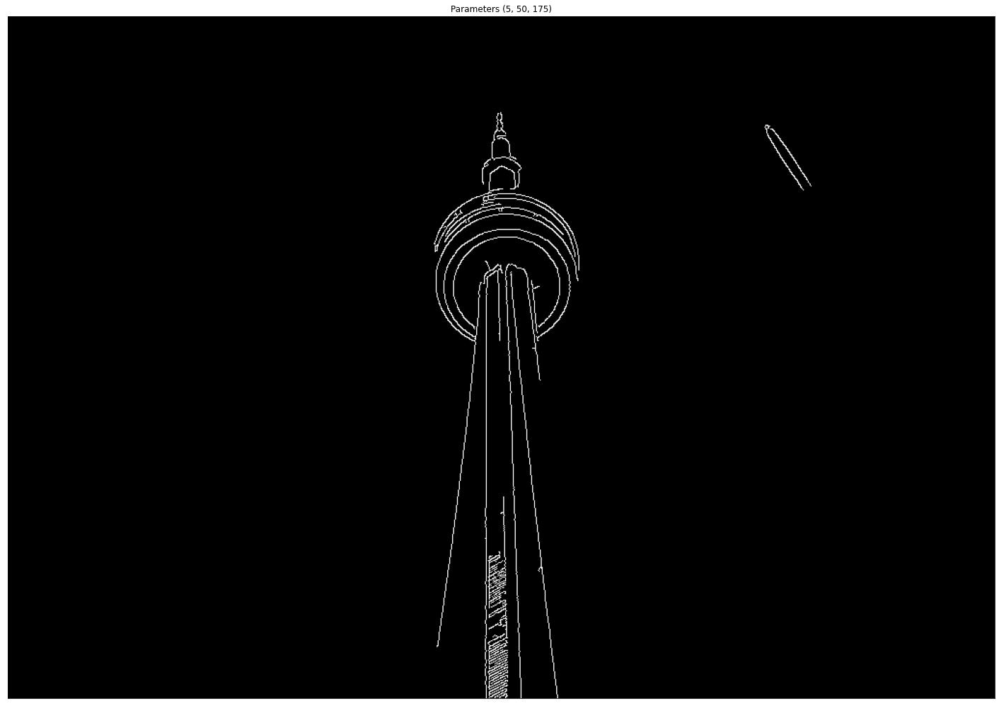

In [79]:
#EDGE DETECTION OF THE CN TOWER

#(13, 50, 150)
img_gauss28 = cv2.GaussianBlur(imageCNTowerGrey, (5, 5), 1)
img_edge_cv28 = cv2.Canny(img_gauss28, 50, 175)

# display image
plt.figure(figsize=(25, 25))

plt.subplot(111), plt.imshow(img_edge_cv28, cmap="gray")
plt.title("Parameters (5, 50, 175)"), plt.xticks([]), plt.yticks([])

plt.show()




From the above image, if we want to isolate the edges of the CN Tower as much as possible while also eliminating the most cloud/sky edges as possible, the combination of parameters that seems to accomplish this task the best is when K = 5, L = 50 and H = 175. It is however important to note that the clound to the right of the CN Tower is formed by very strong edges and is difficult to remove without eliminating CN Tower edges.

## Question 3: Harris Corner Detection (20 Points)

NOTE: The lecture notes were used to implement the Harris Corner Detection method. Furthermore, for non-maxima suppression, Tutorial 3 was used as inspiration as well as the following link from Tutorial 3: https://towardsdatascience.com/canny-edge-detection-step-by-step-in-python-computer-vision-b49c3a2d8123

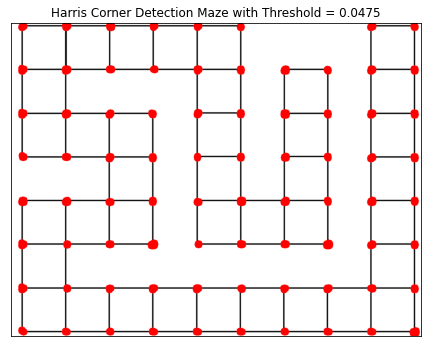

In [80]:
#HARRIS CORNER DETECTION FUNCTION

#Original Maze image
imageMaze = cv2.imread(path+'template_board.png') # BGR
imageMaze = cv2.cvtColor(imageMaze, cv2.COLOR_BGR2RGB)

#Original Shape image
imageShape = cv2.imread(path+'shapes.png') # BGR
imageShape = cv2.cvtColor(imageShape, cv2.COLOR_BGR2RGB)

#Original Building image
imageBuilding = cv2.imread(path+'courthouse.jpg') # BGR
imageBuilding = cv2.cvtColor(imageBuilding, cv2.COLOR_BGR2RGB)

#NON-MAXIMUM SUPPRESSION FROM TUTORIAL 4, other possible implementation of non-maxima suppression
def non_max_suppression(img_mag, img_phs):
    
    M, N = img_mag.shape
    Z = np.zeros((M,N), dtype=np.int32)
    
    # convert img_phs (radian) into angle image
    img_angle = img_phs * 180. / np.pi
    img_angle[img_angle < 0] += 180

    
    for i in range(1,M-1): # Note that we are leaving 1 pixel gap on each side of image
        for j in range(1,N-1): # as for boundary pixels one of its neighbourhood pixel is not defined
            
            # store neighbourhood pixels in variables q and r
            q = 255
            r = 255

            #angle 0
            if (0 <= img_angle[i,j] < 22.5) or (157.5 <= img_angle[i,j] <= 180):
                q = img_mag[i, j+1]
                r = img_mag[i, j-1]
            #angle 45
            elif (22.5 <= img_angle[i,j] < 67.5):
                q = img_mag[i+1, j-1]
                r = img_mag[i-1, j+1]
            #angle 90
            elif (67.5 <= img_angle[i,j] < 112.5):
                q = img_mag[i+1, j]
                r = img_mag[i-1, j]
            #angle 135
            elif (112.5 <= img_angle[i,j] < 157.5):
                q = img_mag[i-1, j-1]
                r = img_mag[i+1, j+1]

            # if pixel magnitude is higher than both its neighbour than keep     
            if (img_mag[i,j] >= q) and (img_mag[i,j] >= r):
                Z[i,j] = img_mag[i,j]
            # otherwise make its value to 0
            else:
                Z[i,j] = 0
    
    return Z


def HarrisCornerDetection(image, k, threshold):
  #Make sure image is Gray!
  imageColour = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
  imageGray = cv2.cvtColor(imageColour, cv2.COLOR_RGB2GRAY) #Image converted to gray

  #Optional step: Blur image
  #img_gaussBlur = cv2.GaussianBlur(imageGray, (3, 3), 1)

  #Step 1: Compute the image derivatives
  #We will use the sobel filters/openCV function to calculate the derivatives
  I_x = cv2.Sobel(imageGray, -1, 1, 0, ksize=5) #Maybe 21 instead?
  I_y = cv2.Sobel(imageGray, -1, 0, 1, ksize=5)

  #OPTIONAL Step 1.2: Calculate image magnitude and phase (Useful for Non-maxima suppression later!)
  # I_m = cv2.magnitude(I_x, I_y)
  # I_p = cv2.phase(I_x, I_y)

  #Step 2: Compute the square of the derivatives
  I_x2 = np.square(I_x)
  I_y2 = np.square(I_y)
  I_xy = I_x * I_y

  #Step 3: Apply the Gaussian filter on the outputs of step 2
  g_x2 = cv2.GaussianBlur(I_x2, (3, 3), 1)
  g_y2 = cv2.GaussianBlur(I_y2, (3, 3), 1)
  g_xy = cv2.GaussianBlur(I_xy, (3, 3), 1)

  #Step 4: Compute the cornerness function response: Determinant(H) − kTrace(H)2), where k=0.05.
  H = g_x2*g_y2 - np.square(g_xy)-k*(np.square(g_x2 + g_y2))

  #OPTIONAL STEP: NORMALIZING
  cv2.normalize(H, H, 0, 1, cv2.NORM_MINMAX)

  #STEP 5: NON-MAXIMUM SUPPRESSION
  #Z = non_max_suppression(I_m, I_p)  
  loc1 = np.where(H >= threshold)
  #loc2 = np.where(Z >= threshold)
  
  # drawing filtered points
  for pt in zip(*loc1[::-1]):
      cv2.circle(imageColour, pt, 10, (255, 0, 0), -1)

  return imageColour 



# display images
plt.figure(figsize=(25, 25))

plt.subplot(131), plt.imshow(HarrisCornerDetection(imageMaze, 0.05, 0.0475))
plt.title("Harris Corner Detection Maze with Threshold = 0.0475"), plt.xticks([]), plt.yticks([])

plt.show()





The above image resembles the output of figure 6 with its Harris' corners detected.

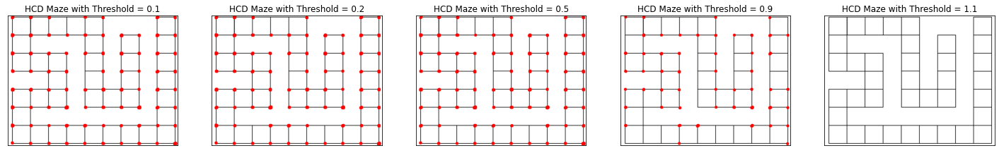

In [81]:
#Playing with the threshold values for Maze image:

plt.figure(figsize=(25, 25))

plt.subplot(151), plt.imshow(HarrisCornerDetection(imageMaze, 0.05, 0.1))
plt.title("HCD Maze with Threshold = 0.1"), plt.xticks([]), plt.yticks([])

plt.subplot(152), plt.imshow(HarrisCornerDetection(imageMaze, 0.05, 0.2))
plt.title("HCD Maze with Threshold = 0.2"), plt.xticks([]), plt.yticks([])

plt.subplot(153), plt.imshow(HarrisCornerDetection(imageMaze, 0.05, 0.5))
plt.title("HCD Maze with Threshold = 0.5"), plt.xticks([]), plt.yticks([])

plt.subplot(154), plt.imshow(HarrisCornerDetection(imageMaze, 0.05, 0.9))
plt.title("HCD Maze with Threshold = 0.9"), plt.xticks([]), plt.yticks([])

plt.subplot(155), plt.imshow(HarrisCornerDetection(imageMaze, 0.05, 1.1))
plt.title("HCD Maze with Threshold = 1.1"), plt.xticks([]), plt.yticks([])

plt.show()



As the threshold value increases, less and less corners are detected. This makes sense given that the threshold value is the value for which we decide whether or not to consider a pixel to be a corner. Therefore, if we increase the threshold, only the strongest of the strongest corners will be kept while other corners will not.

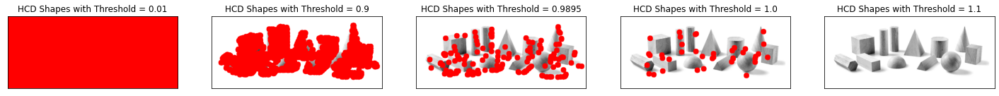

In [82]:
#Playing with the threshold values for Shapes image:

plt.figure(figsize=(25, 25))

plt.subplot(151), plt.imshow(HarrisCornerDetection(imageShape, 0.05, 0.01))
plt.title("HCD Shapes with Threshold = 0.01"), plt.xticks([]), plt.yticks([])

plt.subplot(152), plt.imshow(HarrisCornerDetection(imageShape, 0.05, 0.9))
plt.title("HCD Shapes with Threshold = 0.9"), plt.xticks([]), plt.yticks([])

plt.subplot(153), plt.imshow(HarrisCornerDetection(imageShape, 0.05, 0.9895))
plt.title("HCD Shapes with Threshold = 0.9895"), plt.xticks([]), plt.yticks([])

plt.subplot(154), plt.imshow(HarrisCornerDetection(imageShape, 0.05, 1.0))
plt.title("HCD Shapes with Threshold = 1.0"), plt.xticks([]), plt.yticks([])

plt.subplot(155), plt.imshow(HarrisCornerDetection(imageShape, 0.05, 1.1))
plt.title("HCD Shapes with Threshold = 1.1"), plt.xticks([]), plt.yticks([])

plt.show()

Much like for the Maze image, as we increase the threshold, less and less corners are detected. Furhthermore, we can notice that the developped algorithm seems to be less effective at finding corners in this image.

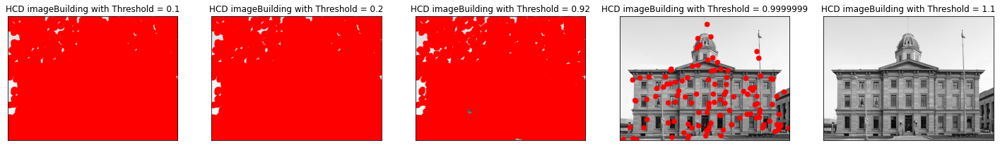

In [83]:
#Playing with the threshold values for Building image:

plt.figure(figsize=(25, 25))

plt.subplot(151), plt.imshow(HarrisCornerDetection(imageBuilding, 0.05, 0.1))
plt.title("HCD imageBuilding with Threshold = 0.1"), plt.xticks([]), plt.yticks([])

plt.subplot(152), plt.imshow(HarrisCornerDetection(imageBuilding, 0.05, 0.2))
plt.title("HCD imageBuilding with Threshold = 0.2"), plt.xticks([]), plt.yticks([])

plt.subplot(153), plt.imshow(HarrisCornerDetection(imageBuilding, 0.05, 0.92))
plt.title("HCD imageBuilding with Threshold = 0.92"), plt.xticks([]), plt.yticks([])

plt.subplot(154), plt.imshow(HarrisCornerDetection(imageBuilding, 0.05, 0.9999999))
plt.title("HCD imageBuilding with Threshold = 0.9999999"), plt.xticks([]), plt.yticks([])

plt.subplot(155), plt.imshow(HarrisCornerDetection(imageBuilding, 0.05, 1.1))
plt.title("HCD imageBuilding with Threshold = 1.1"), plt.xticks([]), plt.yticks([])

plt.show()

###########################
#####DEBUGGING PURPOSES####
###########################


#########################################################
## HARRIS CORNER DETECTOR FROM TUTORIAL 4 USING OPENCV ##
#########################################################

# # load image as grayscale
# img = cv2.imread(path+"shapes.png")
# #shapes.png

# # copy image
# img_disp = img.copy()

# # convert to grayscale
# img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# # detect harris corners
# # cv2.cornerHarris(src, blocksize, sobelKernelSize, Harris_k)
# #                  src --> image for harris corener detection
# #                  blocksize --> accumulates derivatives (Entries of H matrix) over a neighbourhood.
# #                  sobelkernalsize --> size of sobel kernel
# #                  harris_k --> K hyperparameter of harris corner detector

# corners = cv2.cornerHarris(img_gray, 2, 3, 0.04)

# print("Before Normalization")
# print(np.min(corners))
# print(np.max(corners))

# # normalize corner map [0,1]
# # cv2.normalize(src, dst, alpha, beta, norm_type)
# # min_I(dst(I)) = alpha, max_I(dst(I)) = beta
# cv2.normalize(corners, corners, 0, 1, cv2.NORM_MINMAX)

# # print("After Normalization")
# # print(np.min(corners))
# # print(np.max(corners))

# # threshold for an optimal value
# thres = 0.885

# # list all points higher than threshold
# loc = np.where(corners >= thres)

# print("shape of cornerness function output -- same as image: ", corners.shape)
# print("X axis of corners after thresholding: ", loc[0].shape)
# print("Y axis of corners after thresholding: ", loc[1].shape)
# print("First 9 corners -- X-axis location: ", loc[0][0:9])
# print("First 9 corners -- Y-axis location: ", loc[1][0:9])
# print("First 9 corners -- cornerness function output: ",corners[loc[0][0:9], loc[1][0:9]])

# # loop though points
# for pt in zip(*loc[::-1]):
#     # draw filled circle on each point
#     # cv2.circle(img, center, radius, color[, thickness[, lineType[, shift]]]) → None
#     cv2.circle(img_disp, pt, 15, (255,0,0), -1)

# # display images
# plt.figure(figsize=(10,10))
# plt.subplot(121), plt.imshow(img)
# plt.title("Input Image"), plt.xticks([]), plt.yticks([])
# plt.subplot(122), plt.imshow(img_disp)
# plt.title("Harris Corners"), plt.xticks([]), plt.yticks([])
# plt.show()

Much like for the Maze and Shape images, as we increase the threshold, less and less corners are detected. 

## Question 4: Invariance of SIFT Features (30 points)
Part 4.1: Shift in a nutshell

In general, SIFT can be briefly explained in the following steps. 

First off, we must create Laplacian or Difference-of-Gaussian (DoG) image pyramid, which can be done by filtering the image at a range of scales. 

Secondly, we must do SIFT key localization, also known as feature detection. For this step, we detect the extrema of DoG images in scale space. To accomplish this, we iterate through each pixel and check all it's neighbours within the current image, the above image and the below image within the pyramid.

Thirdly, we must eliminate unstable keypoints by discarding DoG values below a
certain threshold. We also must handle edges that may have high contrast in one direction while having low contrast in another.

Finally, we want to select a canonical orientation for the SIFT keypoint. To do this, we can create a Gaussian weighted histogram of local gradient directions depending on a selected scale and ratio. We then assign a canonical orientation to be a peak if it is at least 80% of the max value of the smoothed histogram. A key can have up to 4 canonical orientations, and each key must provide stable 2D coordinates (x, y, scale,orientation).

//


NOTE: FOR THE FOLLOWING PARTS (4.2 and 4.3) MUCH OF THE CODE FROM TUROTIAL 4, WHERE SIFT DETECTION WAS INTRODUCED, WAS USED AS A BASELINE TO ACCOMPLISH THE GIVEN TASKS OF THE ASSIGNMENT.


//




Part 4.2: Invariance under scale

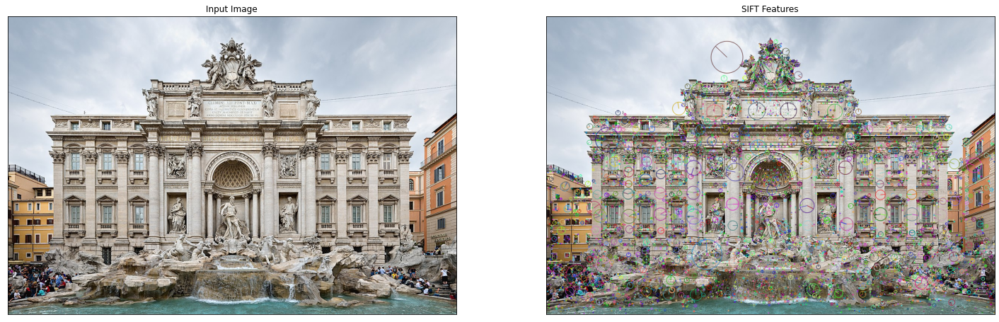

Num keypoints: 7222


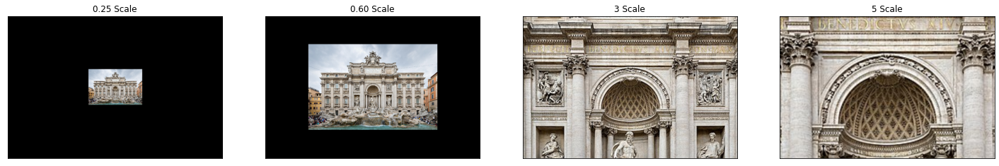

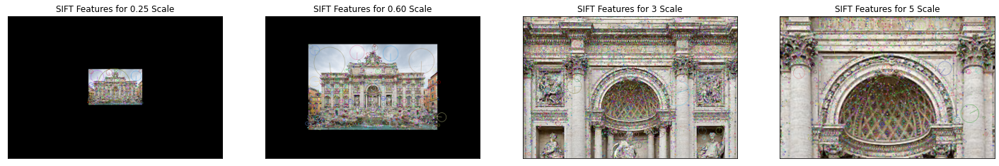

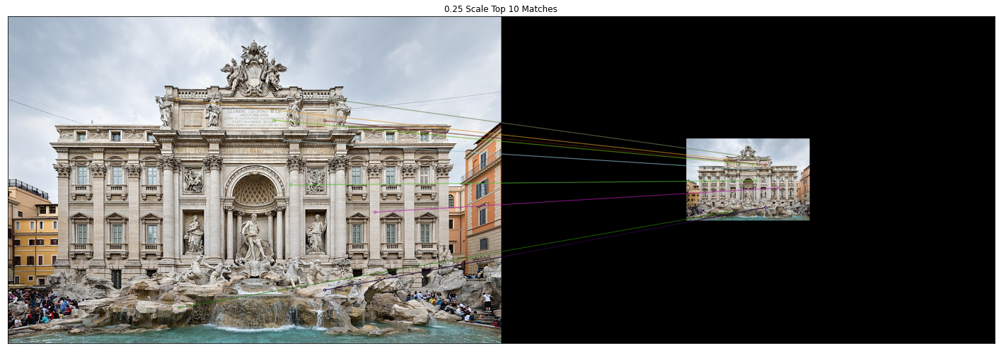

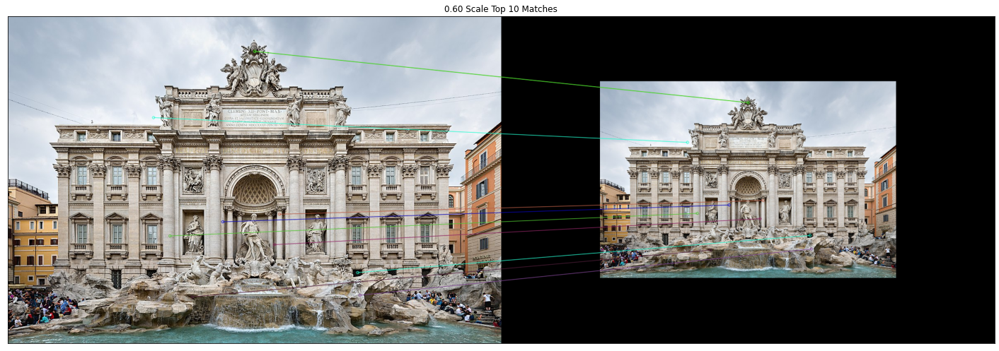

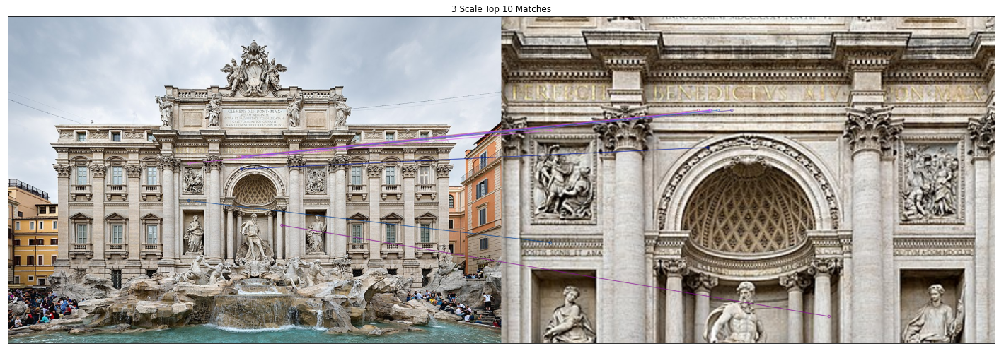

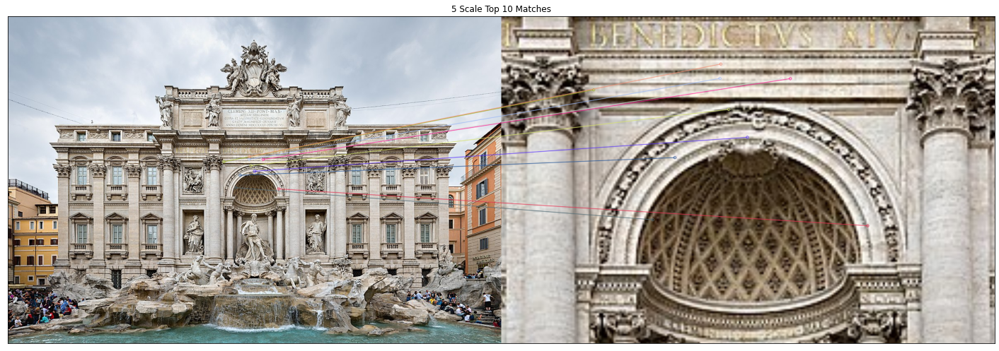

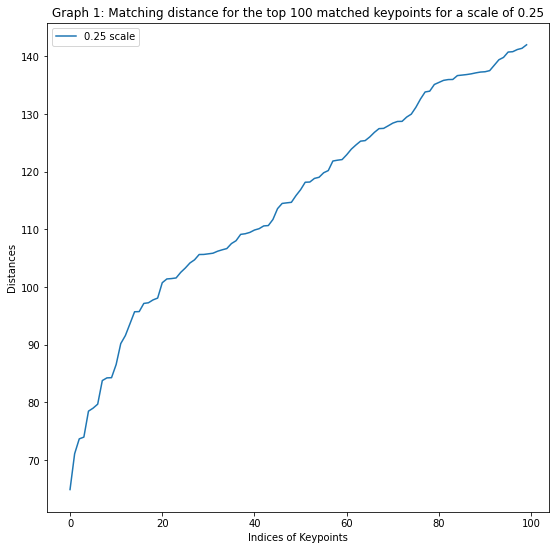

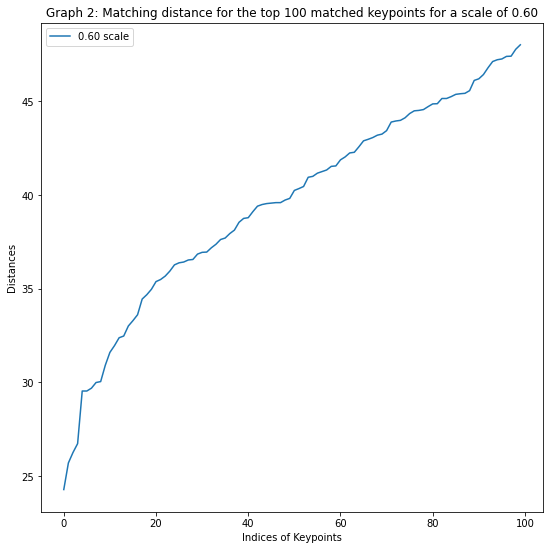

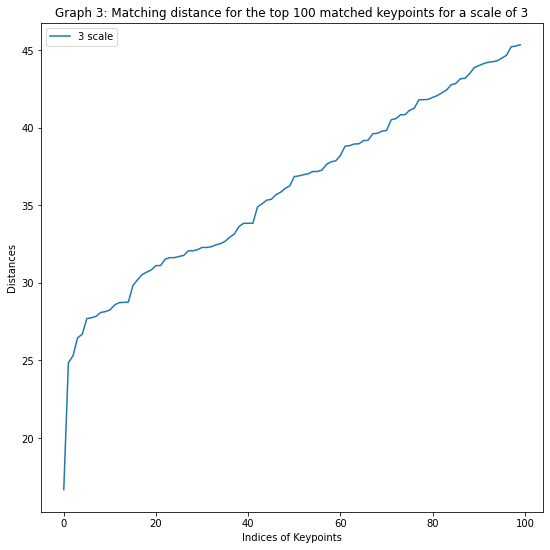

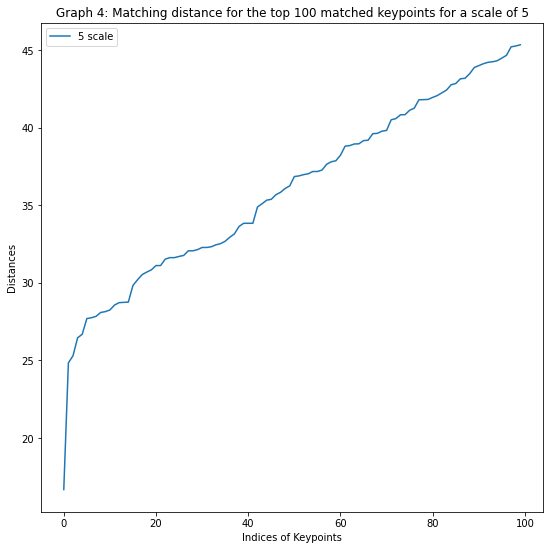

In [84]:
#1. COMPUTE THE SIFT KEYPOINTS FOR THE REFERENCED IMAGE

#Load Trevi Fountain image
imageTFOri = cv2.imread(path+"TreviFountainRome.jpg")

# convert to RGB
imageTF = cv2.cvtColor(imageTFOri, cv2.COLOR_BGR2RGB)
imageTFCopy = cv2.cvtColor(imageTFOri, cv2.COLOR_BGR2RGB)

#Creating a SIFT object
sift = cv2.xfeatures2d.SIFT_create()

# detect SIFT features, with no masks
keypoints = sift.detect(imageTF, None)

# draw the keypoints
cv2.drawKeypoints(imageTF, keypoints, imageTFCopy, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

# display
plt.figure(figsize=(25,25))
plt.subplot(121), plt.imshow(imageTF)
plt.title("Input Image"), plt.xticks([]), plt.yticks([])
plt.subplot(122), plt.imshow(imageTFCopy)
plt.title("SIFT Features"), plt.xticks([]), plt.yticks([])
plt.show()

# num of SIFT keypoints
print('Num keypoints: '+ str(len(keypoints)))

#2. Scale reference image using scaling factors of (0.25, 0.6, 3, 5)
img1 = cv2.imread(path+"TreviFountainRome.jpg")
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
height, width = img1.shape[0:2] # image size

#Create scales
M025 = cv2.getRotationMatrix2D((width/2,height/2),0,0.25)
M060 = cv2.getRotationMatrix2D((width/2,height/2),0,0.60)
M3 = cv2.getRotationMatrix2D((width/2,height/2),0,3)
M5 = cv2.getRotationMatrix2D((width/2,height/2),0,5)

#Apply transformation matrices
img025 = cv2.warpAffine(img1,M025,(width,height))
img060 = cv2.warpAffine(img1,M060,(width,height))
img3 = cv2.warpAffine(img1,M3,(width,height))
img5 = cv2.warpAffine(img1,M5,(width,height))

#Display scaled images
plt.figure(figsize=(25, 25))

plt.subplot(141), plt.imshow(img025)
plt.title("0.25 Scale"), plt.xticks([]), plt.yticks([])

plt.subplot(142), plt.imshow(img060)
plt.title("0.60 Scale"), plt.xticks([]), plt.yticks([])

plt.subplot(143), plt.imshow(img3)
plt.title("3 Scale"), plt.xticks([]), plt.yticks([])

plt.subplot(144), plt.imshow(img5)
plt.title("5 Scale"), plt.xticks([]), plt.yticks([])

plt.show()

#3. Sift Keypoints for all images

#Creating SIFT objects
sift025 = cv2.xfeatures2d.SIFT_create()
sift060 = cv2.xfeatures2d.SIFT_create()
sift3 = cv2.xfeatures2d.SIFT_create()
sift5 = cv2.xfeatures2d.SIFT_create()

# detect SIFT features, with no masks
keypoints025 = sift.detect(img025, None)
keypoints060 = sift.detect(img060, None)
keypoints3 = sift.detect(img3, None)
keypoints5 = sift.detect(img5, None)

#Image Copies
image025Copy = cv2.cvtColor(img025, cv2.COLOR_BGR2RGB)
image060Copy = cv2.cvtColor(img060, cv2.COLOR_BGR2RGB)
image3Copy = cv2.cvtColor(img3, cv2.COLOR_BGR2RGB)
image5Copy = cv2.cvtColor(img5, cv2.COLOR_BGR2RGB)

# draw the keypoints
cv2.drawKeypoints(img025, keypoints025, image025Copy, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
cv2.drawKeypoints(img060, keypoints060, image060Copy, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
cv2.drawKeypoints(img3, keypoints3, image3Copy, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
cv2.drawKeypoints(img5, keypoints5, image5Copy, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

# display
plt.figure(figsize=(25,25))

plt.subplot(141), plt.imshow(image025Copy)
plt.title("SIFT Features for 0.25 Scale"), plt.xticks([]), plt.yticks([])

plt.subplot(142), plt.imshow(image060Copy)
plt.title("SIFT Features for 0.60 Scale"), plt.xticks([]), plt.yticks([])

plt.subplot(143), plt.imshow(image3Copy)
plt.title("SIFT Features for 3 Scale"), plt.xticks([]), plt.yticks([])

plt.subplot(144), plt.imshow(image5Copy)
plt.title("SIFT Features for 5 Scale"), plt.xticks([]), plt.yticks([])

plt.show()

#4. Match all Keypoints between the reference image and the transformed image

# Compute the keypoints/descriptors
keypointsRef,descriptorsRef = sift.detectAndCompute(img1,None)
keypoints025,descriptors025 = sift.detectAndCompute(img025,None)
keypoints060,descriptors060 = sift.detectAndCompute(img060,None)
keypoints3,descriptors3 = sift.detectAndCompute(img3,None)
keypoints5,descriptors5 = sift.detectAndCompute(img5,None)

#Create a bfMatcher object
bf025 = cv2.BFMatcher()#cv2.NORM_HAMMING, crossCheck=True)
bf060 = cv2.BFMatcher()#cv2.NORM_HAMMING, crossCheck=True)
bf3 = cv2.BFMatcher()#cv2.NORM_HAMMING, crossCheck=True)
bf5 = cv2.BFMatcher()#cv2.NORM_HAMMING, crossCheck=True)

#Find Matches
matches025Unsorted = bf025.match(descriptorsRef,descriptors025) #Source image, Scaled image
matches060Unsorted = bf060.match(descriptorsRef,descriptors060)
matches3Unsorted = bf3.match(descriptorsRef,descriptors3)
matches5Unsorted = bf5.match(descriptorsRef,descriptors5)

#5. Sort matching keypoints according to matching distance
matches025 = sorted(matches025Unsorted, key = lambda x:x.distance)
matches060 = sorted(matches060Unsorted, key = lambda x:x.distance)
matches3 = sorted(matches3Unsorted, key = lambda x:x.distance)
matches5 = sorted(matches5Unsorted, key = lambda x:x.distance)

#6. Display the top 10 matched keypoints 
imgM025 = cv2.drawMatches(img1,keypointsRef,img025,keypoints025, matches025[:10], None, flags=2)
imgM060 = cv2.drawMatches(img1,keypointsRef,img060,keypoints060, matches060[:10], None, flags=2)
imgM3 = cv2.drawMatches(img1,keypointsRef,img3,keypoints3, matches3[:10], None, flags=2)
imgM5 = cv2.drawMatches(img1,keypointsRef,img5,keypoints5, matches5[:10], None, flags=2)


#Display scaled images
plt.figure(figsize=(25, 25))

plt.subplot(111), plt.imshow(imgM025)
plt.title("0.25 Scale Top 10 Matches"), plt.xticks([]), plt.yticks([])

plt.show()


plt.figure(figsize=(25, 25))

plt.subplot(111), plt.imshow(imgM060)
plt.title("0.60 Scale Top 10 Matches"), plt.xticks([]), plt.yticks([])

plt.show()

plt.figure(figsize=(25, 25))

plt.subplot(111), plt.imshow(imgM3)
plt.title("3 Scale Top 10 Matches"), plt.xticks([]), plt.yticks([])

plt.show()

plt.figure(figsize=(25, 25))

plt.subplot(111), plt.imshow(imgM5)
plt.title("5 Scale Top 10 Matches"), plt.xticks([]), plt.yticks([])

plt.show()

#7. Plot the matching distance for the top 100 matched keypoints. 
#Plot indices of keypoints on the x-axis and corresponding matching distance on the y- axis.

# Iterate over the matches

#Plot for 0.25
GoodMatches025 = []
for i, m in enumerate(matches025):
    if i == 100:
      break
    else:
        GoodMatches025.append(m.distance)


plt.figure(figsize=(9, 9))
plt.title("Graph 1: Matching distance for the top 100 matched keypoints for a scale of 0.25")
plt.plot(GoodMatches025)
plt.legend(["0.25 scale"])
# naming the x axis
plt.xlabel('Indices of Keypoints')
# naming the y axis
plt.ylabel('Distances')
plt.show()

#Plot for 0.60
GoodMatches060 = []
for i, m in enumerate(matches060):
    if i == 100:
      break
    else:
        GoodMatches060.append(m.distance)


plt.figure(figsize=(9, 9))
plt.title("Graph 2: Matching distance for the top 100 matched keypoints for a scale of 0.60")
plt.plot(GoodMatches060)
plt.legend(["0.60 scale"])
# naming the x axis
plt.xlabel('Indices of Keypoints')
# naming the y axis
plt.ylabel('Distances')
plt.show()


#Plot for 3
GoodMatches3 = []
for i, m in enumerate(matches3):
    if i == 100:
      break
    else:
        GoodMatches3.append(m.distance)


plt.figure(figsize=(9, 9))
plt.title("Graph 3: Matching distance for the top 100 matched keypoints for a scale of 3")
plt.plot(GoodMatches3)
plt.legend(["3 scale"])
# naming the x axis
plt.xlabel('Indices of Keypoints')
# naming the y axis
plt.ylabel('Distances')
plt.show()

#Plot for 5
GoodMatches5 = []
for i, m in enumerate(matches5):
    if i == 100:
      break
    else:
        GoodMatches5.append(m.distance)


plt.figure(figsize=(9, 9))
plt.title("Graph 4: Matching distance for the top 100 matched keypoints for a scale of 5")
plt.plot(GoodMatches3)
plt.legend(["5 scale"])
# naming the x axis
plt.xlabel('Indices of Keypoints')
# naming the y axis
plt.ylabel('Distances')
plt.show()




8.Discuss the trend in the plotted results. What is the effect of increasing the scale on the matching distance? Explain.

As we can see, when increasing the scale of an image, the matching distance decreases. This seems rather logical given that when we increaes the size of an image, the scaled images' features get closer from the original image's features.

Part 4.3: Invariance under rotation

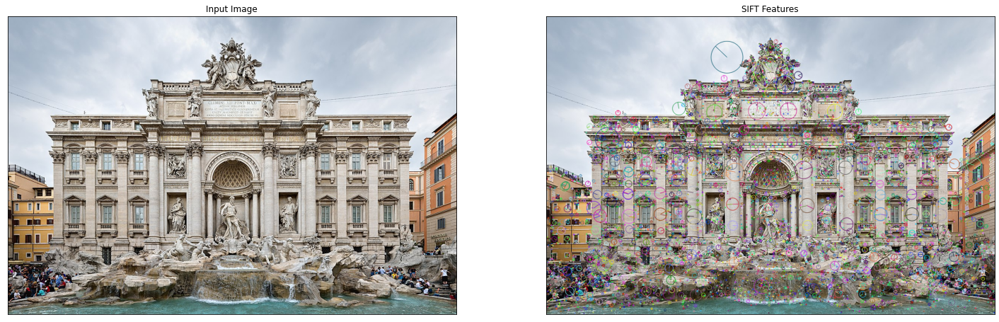

Num keypoints: 7222


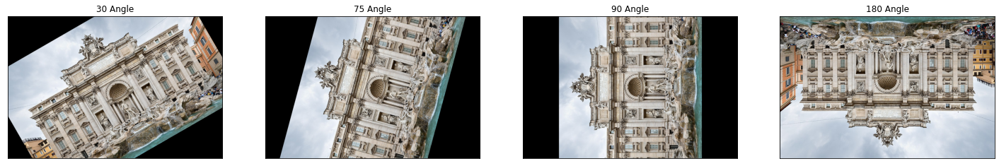

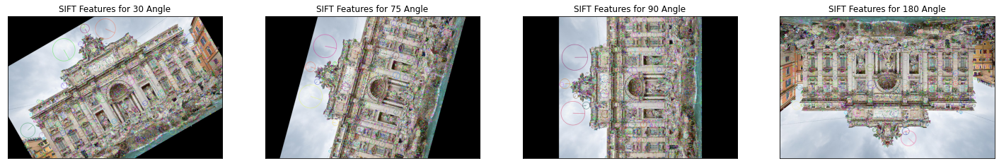

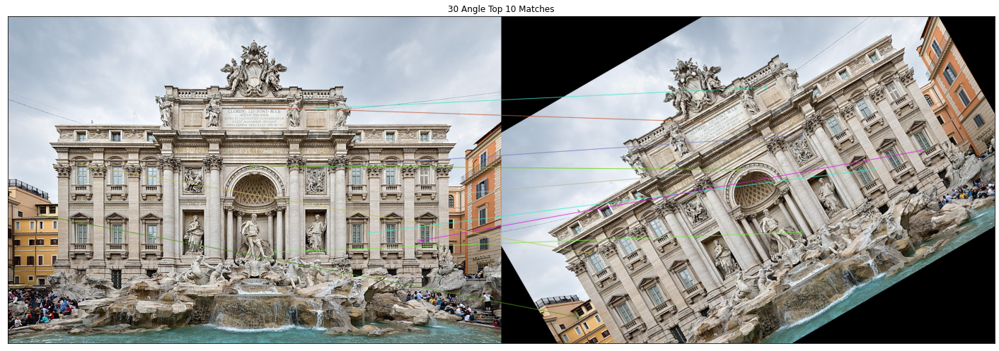

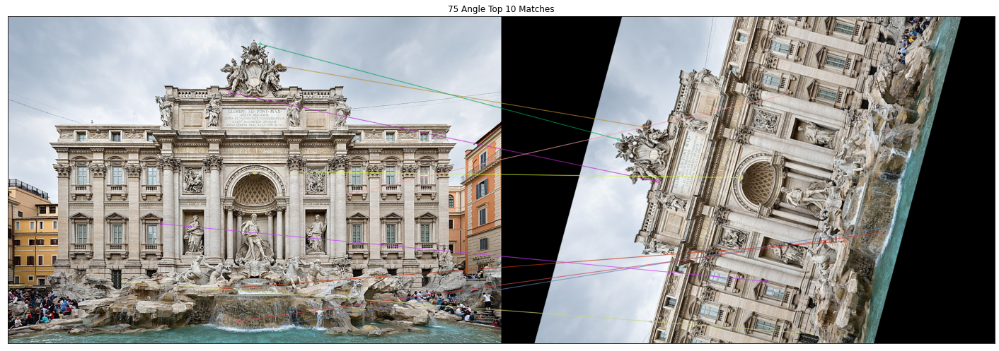

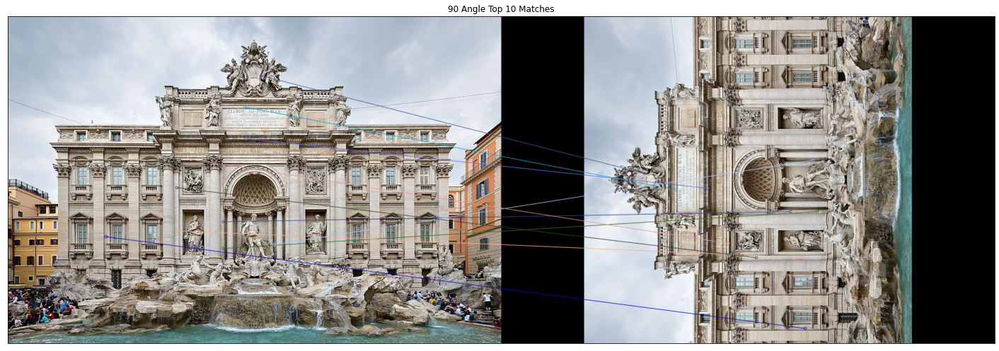

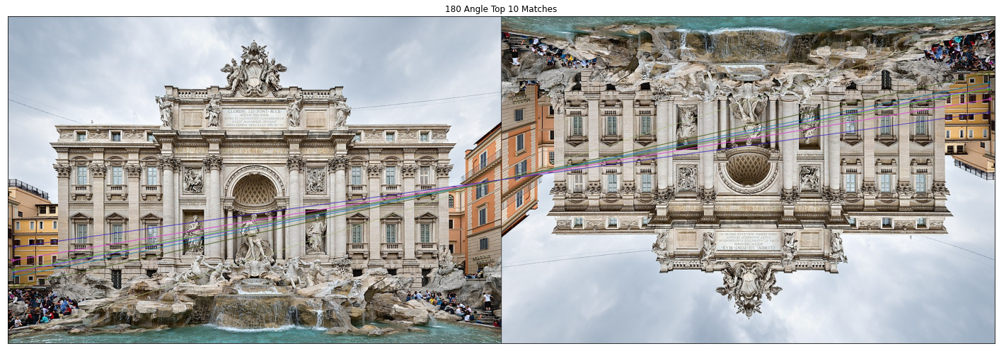

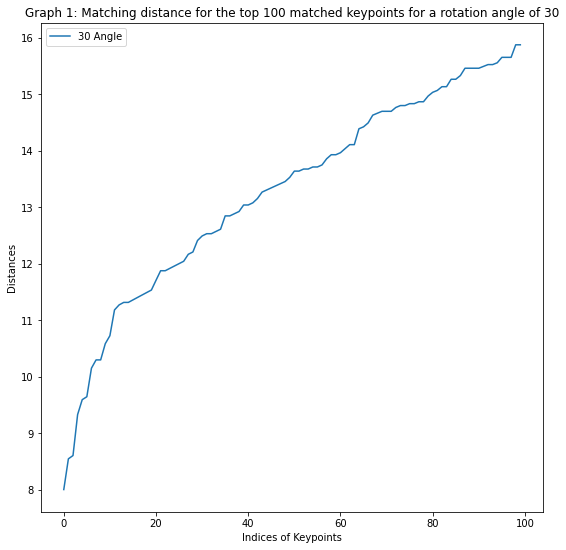

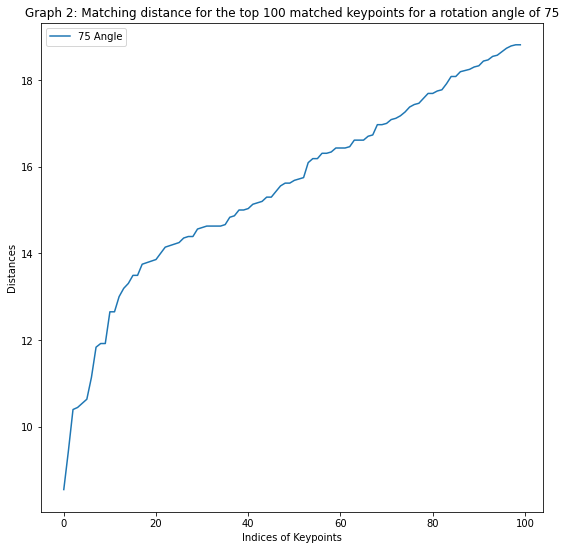

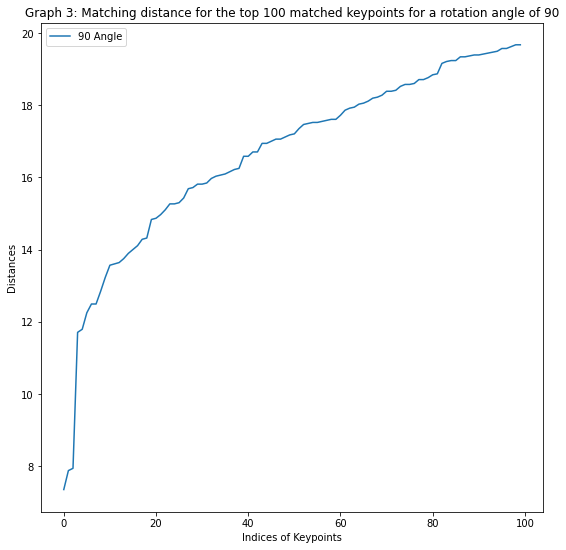

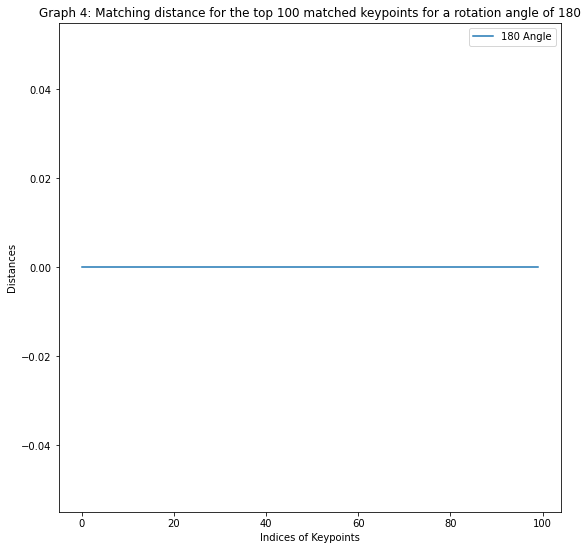

In [85]:
#COMPUTE THE SIFT KEYPOINTS FOR THE REFERENCED IMAGE

#Load Trevi Fountain image
imageTFOri = cv2.imread(path+"TreviFountainRome.jpg")

# convert to RGB
imageTF = cv2.cvtColor(imageTFOri, cv2.COLOR_BGR2RGB)
imageTFCopy = cv2.cvtColor(imageTFOri, cv2.COLOR_BGR2RGB)

#Creating a SIFT object
sift = cv2.xfeatures2d.SIFT_create()

# detect SIFT features, with no masks
keypoints = sift.detect(imageTF, None)

# draw the keypoints
cv2.drawKeypoints(imageTF, keypoints, imageTFCopy, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

# display
plt.figure(figsize=(25,25))
plt.subplot(121), plt.imshow(imageTF)
plt.title("Input Image"), plt.xticks([]), plt.yticks([])
plt.subplot(122), plt.imshow(imageTFCopy)
plt.title("SIFT Features"), plt.xticks([]), plt.yticks([])
plt.show()

# num of SIFT keypoints
print('Num keypoints: '+ str(len(keypoints)))

#1. Scale reference image using angles factors of (30, 75, 90, 180)
img1 = cv2.imread(path+"TreviFountainRome.jpg")
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
height, width = img1.shape[0:2] # image size

#Create scales
M30 = cv2.getRotationMatrix2D((width/2,height/2),30,1)
M75 = cv2.getRotationMatrix2D((width/2,height/2),75,1)
M90 = cv2.getRotationMatrix2D((width/2,height/2),90,1)
M180 = cv2.getRotationMatrix2D((width/2,height/2),180,1)

#Apply transformation matrices
img30 = cv2.warpAffine(img1,M30,(width,height))
img75 = cv2.warpAffine(img1,M75,(width,height))
img90 = cv2.warpAffine(img1,M90,(width,height))
img180 = cv2.warpAffine(img1,M180,(width,height))

#Display scaled images
plt.figure(figsize=(25, 25))

plt.subplot(141), plt.imshow(img30)
plt.title("30 Angle"), plt.xticks([]), plt.yticks([])

plt.subplot(142), plt.imshow(img75)
plt.title("75 Angle"), plt.xticks([]), plt.yticks([])

plt.subplot(143), plt.imshow(img90)
plt.title("90 Angle"), plt.xticks([]), plt.yticks([])

plt.subplot(144), plt.imshow(img180)
plt.title("180 Angle"), plt.xticks([]), plt.yticks([])

plt.show()

#2. Sift Keypoints for all images

#Creating SIFT objects
sift30 = cv2.xfeatures2d.SIFT_create()
sift75 = cv2.xfeatures2d.SIFT_create()
sift90 = cv2.xfeatures2d.SIFT_create()
sift180 = cv2.xfeatures2d.SIFT_create()

# detect SIFT features, with no masks
keypoints30 = sift.detect(img30, None)
keypoints75 = sift.detect(img75, None)
keypoints90 = sift.detect(img90, None)
keypoints180 = sift.detect(img180, None)

#Image Copies
image30Copy = cv2.cvtColor(img30, cv2.COLOR_BGR2RGB)
image75Copy = cv2.cvtColor(img75, cv2.COLOR_BGR2RGB)
image90Copy = cv2.cvtColor(img90, cv2.COLOR_BGR2RGB)
image180Copy = cv2.cvtColor(img180, cv2.COLOR_BGR2RGB)

# draw the keypoints
cv2.drawKeypoints(img30, keypoints30, image30Copy, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
cv2.drawKeypoints(img75, keypoints75, image75Copy, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
cv2.drawKeypoints(img90, keypoints90, image90Copy, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
cv2.drawKeypoints(img180, keypoints180, image180Copy, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

# display
plt.figure(figsize=(25,25))

plt.subplot(141), plt.imshow(image30Copy)
plt.title("SIFT Features for 30 Angle"), plt.xticks([]), plt.yticks([])

plt.subplot(142), plt.imshow(image75Copy)
plt.title("SIFT Features for 75 Angle"), plt.xticks([]), plt.yticks([])

plt.subplot(143), plt.imshow(image90Copy)
plt.title("SIFT Features for 90 Angle"), plt.xticks([]), plt.yticks([])

plt.subplot(144), plt.imshow(image180Copy)
plt.title("SIFT Features for 180 Angle"), plt.xticks([]), plt.yticks([])

plt.show()

#3. Match all Keypoints between the reference image and the transformed image

# Compute the keypoints/descriptors
keypointsRef,descriptorsRef = sift.detectAndCompute(img1,None)
keypoints30,descriptors30 = sift.detectAndCompute(img30,None)
keypoints75,descriptors75 = sift.detectAndCompute(img75,None)
keypoints90,descriptors90 = sift.detectAndCompute(img90,None)
keypoints180,descriptors180 = sift.detectAndCompute(img180,None)

#Create a bfMatcher object
bf30 = cv2.BFMatcher()#cv2.NORM_HAMMING, crossCheck=True)
bf75 = cv2.BFMatcher()#cv2.NORM_HAMMING, crossCheck=True)
bf90 = cv2.BFMatcher()#cv2.NORM_HAMMING, crossCheck=True)
bf180 = cv2.BFMatcher()#cv2.NORM_HAMMING, crossCheck=True)

#Find Matches
matches30Unsorted = bf30.match(descriptorsRef,descriptors30) #Source image, Scaled image
matches75Unsorted = bf75.match(descriptorsRef,descriptors75)
matches90Unsorted = bf90.match(descriptorsRef,descriptors90)
matches180Unsorted = bf180.match(descriptorsRef,descriptors180)

#4. Sort matching keypoints according to matching distance
matches30 = sorted(matches30Unsorted, key = lambda x:x.distance)
matches75 = sorted(matches75Unsorted, key = lambda x:x.distance)
matches90 = sorted(matches90Unsorted, key = lambda x:x.distance)
matches180 = sorted(matches180Unsorted, key = lambda x:x.distance)

#5. Display the top 10 matched keypoints 
#img3 = cv2.drawMatches(img1,keypoints1,img2,keypoints2, matches[:10], None, flags=2)
imgM30 = cv2.drawMatches(img1,keypointsRef,img30,keypoints30, matches30[:10], None, flags=2)
imgM75 = cv2.drawMatches(img1,keypointsRef,img75,keypoints75, matches75[:10], None, flags=2)
imgM90 = cv2.drawMatches(img1,keypointsRef,img90,keypoints90, matches90[:10], None, flags=2)
imgM180 = cv2.drawMatches(img1,keypointsRef,img180,keypoints180, matches180[:10], None, flags=2)


#Display scaled images
plt.figure(figsize=(25, 25))

plt.subplot(111), plt.imshow(imgM30)
plt.title("30 Angle Top 10 Matches"), plt.xticks([]), plt.yticks([])

plt.show()


plt.figure(figsize=(25, 25))

plt.subplot(111), plt.imshow(imgM75)
plt.title("75 Angle Top 10 Matches"), plt.xticks([]), plt.yticks([])

plt.show()

plt.figure(figsize=(25, 25))

plt.subplot(111), plt.imshow(imgM90)
plt.title("90 Angle Top 10 Matches"), plt.xticks([]), plt.yticks([])

plt.show()

plt.figure(figsize=(25, 25))

plt.subplot(111), plt.imshow(imgM180)
plt.title("180 Angle Top 10 Matches"), plt.xticks([]), plt.yticks([])

plt.show()

#6. Plot the matching distance for the top 100 matched keypoints. 
#Plot indices of keypoints on the x-axis and corresponding matching distance on the y- axis.

#Plot for 30
GoodMatches30 = []
for i, m in enumerate(matches30):
    if i == 100:
      break
    else:
        GoodMatches30.append(m.distance)


plt.figure(figsize=(9, 9))
plt.title("Graph 1: Matching distance for the top 100 matched keypoints for a rotation angle of 30")
plt.plot(GoodMatches30)
plt.legend(["30 Angle"])
# naming the x axis
plt.xlabel('Indices of Keypoints')
# naming the y axis
plt.ylabel('Distances')
plt.show()

#Plot for 75
GoodMatches75 = []
for i, m in enumerate(matches75):
    if i == 100:
      break
    else:
        GoodMatches75.append(m.distance)


plt.figure(figsize=(9, 9))
plt.title("Graph 2: Matching distance for the top 100 matched keypoints for a rotation angle of 75")
plt.plot(GoodMatches75)
plt.legend(["75 Angle"])
# naming the x axis
plt.xlabel('Indices of Keypoints')
# naming the y axis
plt.ylabel('Distances')
plt.show()

#Plot for 90
GoodMatches90 = []
for i, m in enumerate(matches90):
    if i == 100:
      break
    else:
        GoodMatches90.append(m.distance)


plt.figure(figsize=(9, 9))
plt.title("Graph 3: Matching distance for the top 100 matched keypoints for a rotation angle of 90")
plt.plot(GoodMatches90)
plt.legend(["90 Angle"])
# naming the x axis
plt.xlabel('Indices of Keypoints')
# naming the y axis
plt.ylabel('Distances')
plt.show()

#Plot for 180
GoodMatches180 = []
for i, m in enumerate(matches180):
    if i == 100:
      break
    else:
        GoodMatches180.append(m.distance)


plt.figure(figsize=(9, 9))
plt.title("Graph 4: Matching distance for the top 100 matched keypoints for a rotation angle of 180")
plt.plot(GoodMatches180)
plt.legend(["180 Angle"])
# naming the x axis
plt.xlabel('Indices of Keypoints')
# naming the y axis
plt.ylabel('Distances')
plt.show()


7.Discuss the trend in the plotted results. What is the effect of increasing the angle of rotation on the matching distance? Explain.

As we can see, when increasing the rotation angle, the matching distance increases. This seems rather logical given that when we rotate the image counter-clockwise, the scaled images' features get further from the original image's features.